Code for the blog post: https://summernightsintohoku.wordpress.com/2024/06/24/is-the-martingale-really-a-submartingale/.

In [146]:
import numpy as np
import plotly.offline as pyo
import pandas as pd
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm 

### Global Parameters:

In [113]:
bankroll = 100 # Bankroll relative to initial bet size.
p = 18/37 # Probability of guessing correct color ('Red' or 'Black') in Roulette.

# Simulation 1: Fixed number of rounds with borrowing.

#### Parameters:

In [132]:
simulations1 = 1000000 # Number of bankroll paths to sample 
rounds_per_sim = 100 # Number of rounds of roulette agent plays in each sample
paths_to_plot1 = 20 # Number of paths to plot for figures in 'Plotting Simulated Bank Roll Paths' section

#### Simulating Bankroll Samples:

In [133]:
values = [-1,1]
probabilities = [1.0-p,p]
samples = np.random.choice(values, (simulations1, rounds_per_sim), p=probabilities) # np.array of shape (simulations, rounds_per_sim), each row corresponding to realization of gambling outcomes X_n for n=rounds_per_sim many rounds

#### Roulette function:

In [134]:
def mc_simul_1(outcomes):
    bet_size = 1
    round = 1
    rounds_won = 0
    bankroll = [100]
    amount_borrowed = []
    first_bankruptcy = None
    for outcome in outcomes:
        bankroll.append(bankroll[-1] + bet_size * outcome)
        if outcome == -1:
            bet_size = 2 * bet_size
        else:
            bet_size = 1
            rounds_won += 1
        if bankroll[-1] <= bet_size:
            amount_borrowed.append(bet_size-bankroll[-1]) 
            if first_bankruptcy == None:
                first_bankruptcy = round 
        round += 1
    return bankroll, rounds_won, amount_borrowed, first_bankruptcy

#### Sampling random variables of interest:

In [135]:
br_paths_simul1, Profit, Rounds_won, Max_loan, Num_bankruptcies, First_bankruptcy, Amount_borrowed = [], [], [], [], [], [], []
for row in samples: 
    outcome = list(mc_simul_1(row)) 
    br_paths_simul1.append(outcome[0])
    Profit.append(outcome[0][-1]-100)
    Rounds_won.append(outcome[1])
    Num_bankruptcies.append(len(outcome[2]))
    Amount_borrowed.append(sum(outcome[2]))
    outcome[2].append(0)
    Max_loan.append(max(outcome[2]))
    First_bankruptcy.append(outcome[3])

br_paths_simul1 = np.array(br_paths_simul1)
data = {'Profit:' : Profit, 'Number of Rounds Won:' : Rounds_won, 'Number of Bankruptcies:' : Num_bankruptcies, 'Amount Borrowed:' : Amount_borrowed, 'Maximum Loan Taken:' : Max_loan, 'First Bankruptcy:' : First_bankruptcy}
df_simul1 = pd.DataFrame(data)  
df_simul1.head()

,Profit:,Number of Rounds Won:,Number of Bankruptcies:,Amount Borrowed:,Maximum Loan Taken:,First Bankruptcy:
0,44,51,0,0,0,NaN
1,43,43,2,135,115,17.0
2,48,55,0,0,0,NaN
3,43,50,0,0,0,NaN
4,43,50,0,0,0,NaN


#### Plotting histograms for variables of interest:

In [136]:
# Subplot function
def plot_columns(df,x,y,Units):
    figure, axs = plt.subplots(x,y, tight_layout=True, figsize=(10,6))
    axs = axs.flatten()
    for i, column in enumerate(df): 
        series = df[column].dropna().sort_values()
        axs[i].hist(series)
        axs[i].set_xlabel(Units[i])
        axs[i].set_title(column)
    if len(df.columns) < len(axs):
        figure.delaxes(axs[-1])
    plt.show()

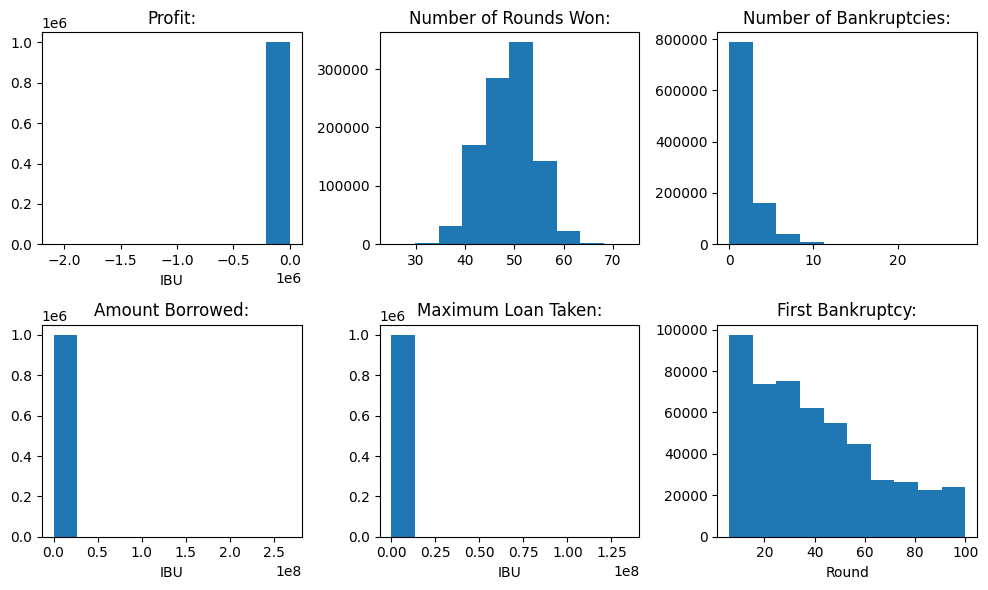

In [137]:
# Plotting column variables
Units=['IBU', None, None, 'IBU', 'IBU', 'Round']
plot_columns(df_simul1,2,3,Units)

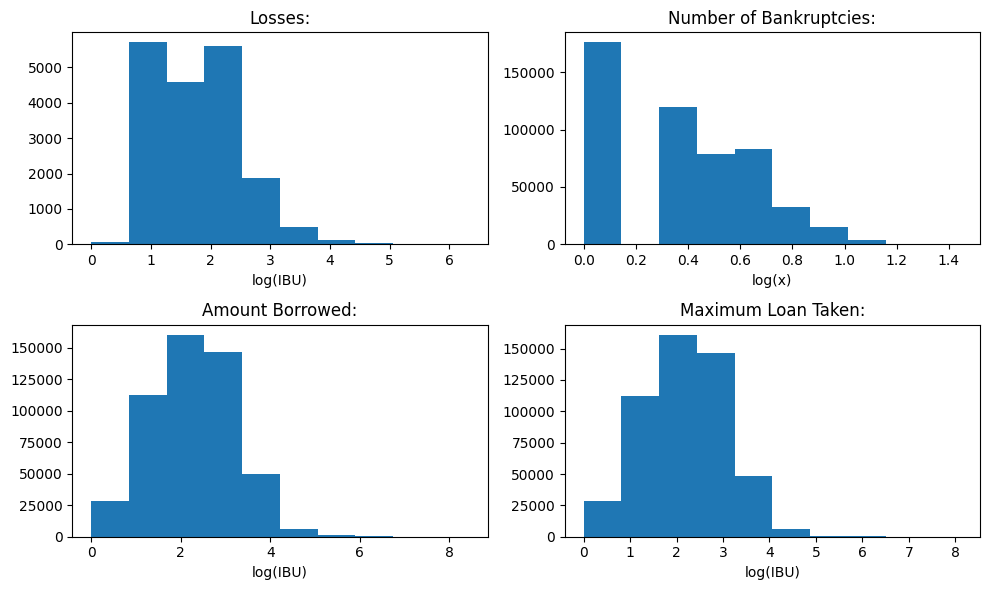

In [138]:
# Plotting log variables for skewed histograms
Units = ['log(IBU)', 'log(x)', 'log(IBU)', 'log(IBU)']
df_simul1['Losses:'] = -df_simul1['Profit:'][df_simul1['Profit:'] <= 0]
log_columns = ['Losses:', 'Number of Bankruptcies:', 'Amount Borrowed:', 'Maximum Loan Taken:']
df_log_simul1 = np.log10(df_simul1[log_columns][df_simul1[log_columns] != 0])
plot_columns(df_log_simul1, 2, 2, Units)

### Empirical Averages:

In [139]:
avg_df_simul1 = df_simul1.mean().round(2) # computing intracolumn averages
avg_df_simul1.index = 'Average ' + avg_df_simul1.index # Relabelling the indices
print(avg_df_simul1)

Average Profit:                      36.22
Average Number of Rounds Won:        48.65
Average Number of Bankruptcies:       1.40
Average Amount Borrowed:           2533.76
Average Maximum Loan Taken:        1302.35
Average First Bankruptcy:            40.01
Average Losses:                     510.73
dtype: float64


In [140]:
# Separate variables conditioned on bankruptcy ocurring (or not).
b_df = df_simul1.loc[df_simul1['Number of Bankruptcies:']>0] # Isolate simulations with bankrupcties
nb_df = df_simul1.loc[df_simul1['Number of Bankruptcies:']==0] # Isolate simulations without bankrupcties
b_avgs = b_df[['Profit:', 'Number of Rounds Won:', 'Number of Bankruptcies:', 'Amount Borrowed:']].mean().round(2) # Compute averages
b_avgs.name = "With Bankruptcy:"
nb_avgs = nb_df[['Profit:', 'Number of Rounds Won:', 'Number of Bankruptcies:', 'Amount Borrowed:']].mean().round(2) # Compute averages
nb_avgs.name = 'Without Bankruptcy:'
nb_avgs[['Number of Bankruptcies:', 'Amount Borrowed:']] = None

print(pd.concat((b_avgs, nb_avgs), axis=1).to_string()) 

                         With Bankruptcy:  Without Bankruptcy:
Profit:                             24.92                47.90
Number of Rounds Won:               46.71                50.66
Number of Bankruptcies:              2.75                  NaN
Amount Borrowed:                  4982.40                  NaN


### Plotting Simulated Bankroll Paths:

In [141]:
fig, fig_nb, fig_worst = go.Figure(), go.Figure(), go.Figure()
x=np.linspace(0,rounds_per_sim,rounds_per_sim)

nb_paths = br_paths_simul1[nb_df.index]

worst_mask = df_simul1['Amount Borrowed:'].sort_values(ascending=False).index[:paths_to_plot1]
worst_paths = br_paths_simul1[worst_mask]

for i in range(paths_to_plot1):
    row = br_paths_simul1[i]
    row_nb = nb_paths[i]
    row_worst = worst_paths[i]
    fig.add_trace(go.Scatter(x=x, y=row, name=f"Simul: {i+1}", showlegend=False))
    fig_nb.add_trace(go.Scatter(x=x, y=row_nb, name=f"Simul: {i+1}", showlegend=False)) 
    fig_worst.add_trace(go.Scatter(x=x, y=row_worst, name=f"Simul: {i+1}", showlegend=False))

 

In [142]:
# figure settings
fig.update_layout(
    title=f"{paths_to_plot1} Simulations of Martingale Betting Strategy for Roulette With Borrowing",
    yaxis=dict(
        title="Bankroll (relative to initial bet)",
        titlefont = dict(
            size=15
        ),
        tickfont = dict(
            size=14
            )),
    xaxis=dict(
        title="Round",
        titlefont = dict(
            size=15
        ),
    tickfont = dict(
        size=14
        )),
 
)
fig.show()

In [143]:
# figure settings
fig_nb.update_layout(
    title=f"{paths_to_plot1} Simulations of Bankroll Paths Without Bankruptcy",
    yaxis=dict(
        title="Bankroll (relative to initial bet)",
        titlefont = dict(
            size=15
        ),
        tickfont = dict(
            size=14
            )),
    xaxis=dict(
        title="Round",
        titlefont = dict(
            size=15
        ),
    tickfont = dict(
        size=14
        )),
    showlegend = False,
)

fig_nb.show()

In [144]:
# figure settings
fig_worst.update_layout(
    title=f"{paths_to_plot1} Simulations of Bankroll Paths Which Accrued Largest Debts",
    yaxis=dict(
        title="Bankroll (relative to initial bet)",
        titlefont = dict(
            size=15
        ),
        tickfont = dict(
            size=14
            )),
    xaxis=dict(
        title="Round",
        titlefont = dict(
            size=15
        ),
    tickfont = dict(
        size=14
        )),
    showlegend = False,
)
fig_worst.show()

# Simulation 2 (Play until bankruptcy).

#### Parameters:

In [91]:
simulations2 = 10000
bankruptcy_threshold = 0.995
max_rounds = 10000
paths_to_plot2 = 20

#### Roulette function:

In [75]:
# Helper function 
def new_bankroll(outcomes, bet_amounts, bankrolls):
    new_bankrolls = np.empty(len(bankrolls))
    for i, bankroll in enumerate(bankrolls):
        bet_amount = min(bet_amounts[i], bankroll)
        outcome = outcomes[i]
        if bankroll > 0:
            new_bankrolls[i] = bankroll + outcome*bet_amount
        else:
            new_bankrolls[i] = 0
    return new_bankrolls

def percent_bankrupt(column):
    is_zero = column == 0
    return np.round(is_zero.sum() / len(column),3)

def within_max(num1, num2):
    if num2 == None:
        return True
    elif num1 <= num2:
        return True
    else:
        return False

In [76]:
def mc_simul_2(simulations, bankruptcy_threshold, max_rounds=None):
    bar1 = tqdm(total=bankruptcy_threshold) # Progress bar for percentage of Bankroll paths which have bankrupted. 
    if max_rounds: 
        bar2 = tqdm(total=max_rounds)# Progress bar for number of gambling rounds simulated if max_rounds is set. 
    bankrolls = np.full(simulations, bankroll, dtype=float) # Starting bankrolls.
    Bankrolls = bankrolls[:, None]
    bet_amounts = np.full(simulations, 1, dtype=float) # Initial bet sizes. 
    outcomes = np.random.choice(values, simulations, p=probabilities) # Generate a single round of gambling outcomes for each simulated path.
    while percent_bankrupt(bankrolls) < bankruptcy_threshold and within_max(Bankrolls.shape[1], max_rounds): # Simulate paths until the bankruptcy threshold is reached, or max_round rounds have occurred (if defined).  
        bankrolls = new_bankroll(outcomes, bet_amounts, bankrolls)
        Bankrolls = np.c_[Bankrolls, bankrolls[:, None]]
        prev_outcomes = outcomes
        outcomes = np.random.choice(values, simulations2, p=probabilities)
        bet_amounts = bet_amounts * (1-prev_outcomes) + 0.5 * (1+prev_outcomes)
        bar1.update(percent_bankrupt(bankrolls)-bar1.n)
        if max_rounds:
            bar2.update(Bankrolls.shape[1]-bar2.n-1)
    if bar1.n != bankruptcy_threshold:
        print(f"{percent_bankrupt(Bankrolls[:,-1])*100}% of simulated paths have bankrupted.")
    bar1.close()
    if max_rounds:
        if bar2.n != max_rounds:
            print(f"The longest simulated path is {Bankrolls.shape[1]} rounds.")
        bar2.close()
    return Bankrolls

In [77]:
Bankrolls=mc_simul_2(simulations2, bankruptcy_threshold, max_rounds)

  0%|          | 0/0.995 [00:00<?, ?it/s]

  0%|          | 0/10000 [00:00<?, ?it/s]

99.3% of simulated paths have bankrupted.


#### Sampling (random) variables of interest from simulated paths:

In [78]:
# Given bankroll path 'row', return bankrupt time if row bankrupts, else return None.
def get_bankrupt_time(row):
    row = list(row)
    if 0 in row:
        return row.index(0)
bankrupt_times = [get_bankrupt_time(row) for row in Bankrolls] 

In [79]:
# Separate paths which end in bankruptcy from those that do not.
bankrupt_mask = np.isin(Bankrolls[:,-1], test_elements=0) 
br_paths_simul2 = Bankrolls[bankrupt_mask]
lucky_mask = np.array(bankrupt_times) == None
lucky_paths = Bankrolls[lucky_mask]

In [80]:
# Find longest winning streak in row if val='w' and longest losing streak if val='l'.
def streak(row, val):
    if val not in {'w', 'l'}:
        print('val must be \'w\' for winning streak or \'l\' for losing streak.')
        return None
    elif val == 'w':
        func = max
    else:
        func = min
    delta = row - row.shift(1)
    count = 0
    streak = 0
    for value in delta[1:]:
        if abs(func([value,0])) > 0:
            count += 1
            if count>streak:
                streak = count
        else:
            count = 0
    return streak

In [81]:
# Return number of round wins in row.
def get_rounds_won(row):
    round_won = (row - row.shift(1))[1:]>0
    return round_won.sum()

In [82]:
bankrupt_times = [time for time in bankrupt_times if time] # remove Nones (i.e. infinite bankrupt times)
df = pd.DataFrame(br_paths_simul2)
rounds_won = df.apply(get_rounds_won, axis = 1)
winning_streaks = df.apply(lambda x: streak(x, 'w'), axis=1) 
losing_streaks = df.apply(lambda x: streak(x, 'l'), axis=1)
max_bankrolls = df.apply(lambda x: np.max(x), axis=1)
data = {'Bankrupt Time:' : bankrupt_times, 'Number of Rounds Won:' : rounds_won, 'Largest Bankroll:' : max_bankrolls, 'Longest Winning Streak:' : winning_streaks, 'Longest Losing Streak:' : losing_streaks}
df_simul2 = pd.DataFrame(data)  
df_simul2.head()

,Bankrupt Time:,Number of Rounds Won:,Largest Bankroll:,Longest Winning Streak:,Longest Losing Streak:
0,70,27,118.0,3,7
1,57,21,108.0,4,7
2,262,124,224.0,6,8
3,29,11,111.0,2,7
4,473,247,347.0,7,9


#### Plotting Histograms

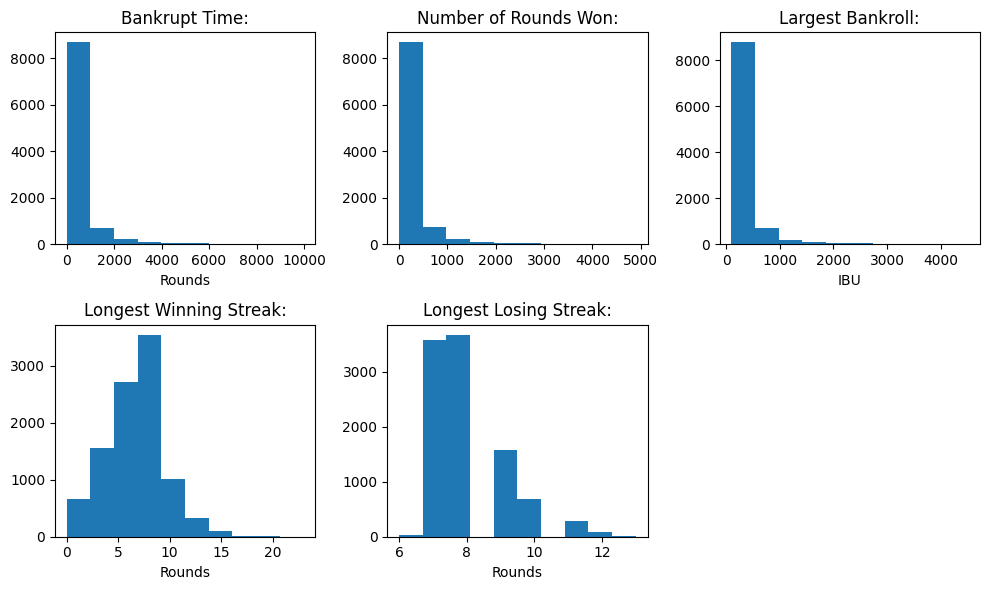

In [83]:
# Plotting column variables
Units=['Rounds', None, 'IBU', 'Rounds', 'Rounds']
plot_columns(df_simul2, 2, 3, Units)

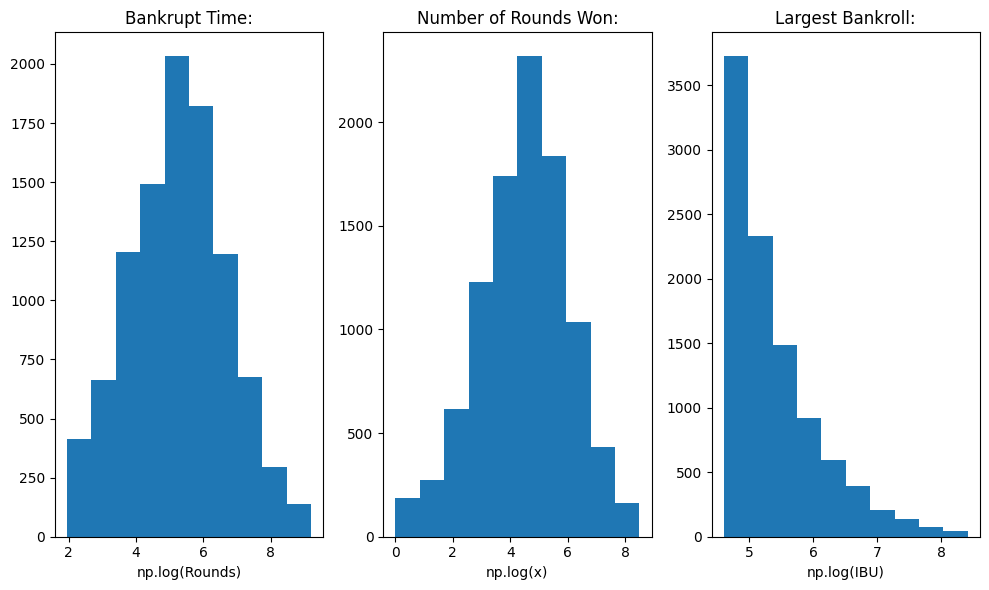

In [84]:
# Plotting log variables for skewed histograms
log_columns = ['Bankrupt Time:', 'Number of Rounds Won:', 'Largest Bankroll:']
Units = ['np.log(Rounds)', 'np.log(x)', 'np.log(IBU)']
df_log_simul2 = np.log(df_simul2[log_columns][df_simul2[log_columns]>0])
plot_columns(df_log_simul2,1,3,Units)

#### Statistics:

In [85]:
# Averages
avg_df_simul2 = df_simul2.mean().round(2) # computing intracolumn averages
avg_df_simul2.index = 'Average ' + avg_df_simul2.index # Relabelling the indices
print(avg_df_simul2)

Average Bankrupt Time:             520.51
Average Number of Rounds Won:      253.12
Average Largest Bankroll:          310.58
Average Longest Winning Streak:      6.60
Average Longest Losing Streak:       8.05
dtype: float64


In [86]:
# Percentiles of bankrupt_times
p25 = np.percentile(bankrupt_times, 25)
p50 = np.percentile(bankrupt_times, 50)
p75 = np.percentile(bankrupt_times, 75)
p99 = np.floor(np.percentile(bankrupt_times, 99))
p999 = np.floor(np.percentile(bankrupt_times, 99.9))


percentile_df = pd.Series(data = [p25,p50,p75,p99,p999], index = ['25th', '50th', '75th', '99th', '99.9th']) 
percentiles = {25:p25, 50:p50, 75:p75, 99:p99, 999:p999}
print("Bankrupt Time Percentiles:")
print(percentile_df.to_string())

Bankrupt Time Percentiles:
25th        69.0
50th       201.0
75th       509.0
99th      5485.0
99.9th    8764.0


### Plotting Simulated Bankroll Paths:

In [106]:
path_length = br_paths_simul2.shape[1]

# Given subarray of br_paths_simul2 of bankroll paths, return first round all paths have bankrupted if it exists, or return common length of paths in br_paths_simul2.
def get_zero_column(array):
    index = path_length
    array = np.abs(array)
    if 0 in list(np.sum(array, axis=0)):
        index = list(np.sum(array, axis=0)).index(0)
    return min(index+1, path_length)

# Plotting path_to_plot2 many bankroll paths which are, arbitrary (for fig), have longest bankrupt times (for fig_best), and have largest losing streaks (for fig_worst). 
fig, fig_best, fig_worst = go.Figure(), go.Figure(), go.Figure()
rounds = path_length-1
x=np.linspace(0,rounds,rounds)

best_mask = df_simul2['Bankrupt Time:'].sort_values(ascending=False).index[:paths_to_plot2]
best_paths = br_paths_simul2[best_mask]
best_paths = best_paths[:,:get_zero_column(best_paths)+1]

worst_mask = df_simul2['Longest Losing Streak:'].sort_values().index[:paths_to_plot2]
worst_paths = br_paths_simul2[worst_mask]

for i in range(paths_to_plot2):
    row = br_paths_simul2[i]
    row_best = best_paths[i]
    row_worst = worst_paths[i]
    fig.add_trace(go.Scatter(x=x, y=row, name=f"Simul: {i+1}", showlegend=False))
    fig_best.add_trace(go.Scatter(x=x, y=row_best, name=f"Simul: {i+1}", showlegend=False)) 
    fig_worst.add_trace(go.Scatter(x=x, y=row_worst, name=f"Simul: {i+1}", showlegend=False))
 

In [107]:
# figure settings
fig.update_layout(
    title=f"{paths_to_plot2} Simulations of Martingale Betting Strategy for Roulette Playing Until Bankruptcy",
    yaxis=dict(
        title="Bankroll (relative to initial bet)",
        titlefont = dict(
            size=15
        ),
        tickfont = dict(
            size=14
            )),
    xaxis_range = [0, get_zero_column(br_paths_simul2[:paths_to_plot2])],
    xaxis=dict(
        title="Round",
        titlefont = dict(
            size=15
        ),
    tickfont = dict(
        size=14
        )), 
)

fig.show()

In [108]:
# figure settings
fig_best.update_layout(
    title=f"{paths_to_plot2} Simulations of Martingale Betting Strategy for Roulette Playing Until Bankruptcy",
    yaxis=dict(
        title="Bankroll (relative to initial bet)",
        titlefont = dict(
            size=15
        ),
        tickfont = dict(
            size=14
            )),
    xaxis=dict(
        title="Round",
        titlefont = dict(
            size=15
        ),
    tickfont = dict(
        size=14
        )), 
)

fig_best.show()

In [111]:
# figure settings
fig_worst.update_layout(
    title=f"{paths_to_plot2} Simulations With Largest Losing Streaks",
    yaxis=dict(
        title="Bankroll (relative to initial bet)",
        titlefont = dict(
            size=15
        ),
        tickfont = dict(
            size=14
            )),
    xaxis_range = [0, get_zero_column(worst_paths)],
    xaxis=dict(
        title="Round",
        titlefont = dict(
            size=15
        ),
    tickfont = dict(
        size=14
        )), 
)

fig_worst.show()